In [1]:
import tomopy
import dxchange
import matplotlib
import matplotlib.pyplot as plt
import datetime
import time
import cv2
import numpy as np
from imagestacks import create_animation
from IPython.core.display import HTML
from skimage.filters import threshold_otsu

astropy module not found


In [2]:
# Selectionner la premiere image (numero 0) du dossier tilt series
fname = 'C:/Users/cayez/Documents/DONNEES SIMON/python/projetMultiTomopy/tilt_0_180/carteSD120321_0000.tif'
ind = list(range(180))
print(fname)

C:/Users/cayez/Documents/DONNEES SIMON/python/projetMultiTomopy/tilt_0_180/carteSD120321_0000.tif


In [53]:
#creer le stack d'images projection
proj = dxchange.reader.read_tiff_stack(fname, ind)

In [54]:
print(np.min(proj[0]),np.max(proj[0]))

8224 65428


---------------------------------------
image entiere


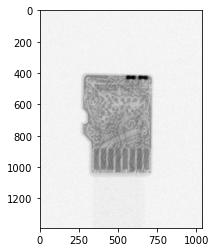

---------------------------------------
image crop


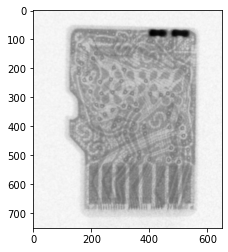

In [55]:
#crop image test sur image 0
# affichage complet
print('---------------------------------------')
print('image entiere')
image0 = proj[0,:,:]
plt.imshow(image0, cmap='Greys_r')
plt.show()
print('---------------------------------------')
print('image crop')
image0 = proj[0,350:1100, 150:800]
plt.imshow(image0, cmap='Greys_r')
plt.show()

In [56]:
print(np.min(proj[0]),np.max(proj[0]))

8224 65428


In [57]:

largeur_crop = image0.shape[0]
hauteur_crop = image0.shape[1]
yxratio = hauteur_crop/largeur_crop
print('ratio',yxratio)

print('taille',largeur_crop,hauteur_crop) 
nombre_images = 180
#construire un tableau vide 
proj_crop = np.ndarray((nombre_images,largeur_crop,hauteur_crop), dtype=np.int32)

#le remplir avec les images crop
for i in range (0,nombre_images):
    proj_crop[i] = proj[i,350:1100, 150:800]
   

ratio 0.8666666666666667
taille 750 650


In [6]:
#verifier si toutes les images rentrent
anim0 = create_animation(proj_crop, 4,4/yxratio)
display(HTML(anim0.to_jshtml()))

In [7]:
# #diminuer la taille des images optionnel)
# print('avant',proj.shape)
# down = tomopy.misc.morph.downsample(proj, level=1, axis=1)
# down = tomopy.misc.morph.downsample(down, level=1, axis=2)
# print('apres',down.shape)

In [8]:
# #afficher la  1ere image avant downsampling
# image0 = proj[0, :, :]
# image0 = proj[0,200:1200, 100:800] 
# plt.imshow(image0, cmap='Greys_r')
# plt.show()

In [9]:
# #afficher la  1ere image apres downsampling
# image0 = down[0, :, :]
# plt.imshow(image0, cmap='Greys_r')
# plt.show()

In [10]:
# anim2 = create_animation(down, size=4)
# display(HTML(anim2.to_jshtml()))

In [64]:
print(np.min(proj_crop[0]),np.max(proj_crop[0]))

8224 64751


In [65]:
normbg = tomopy.prep.normalize.normalize_bg(proj_crop)

In [66]:
print(np.min(normbg[0]),np.max(normbg[0]))

0.13712752 1.1080917


In [67]:
#normaliser ave loi log pour loi de beer lambert
# norm = tomopy.prep.normalize.minus_log(proj_crop, ncore=None, out=None)
norm =tomopy.minus_log(normbg )

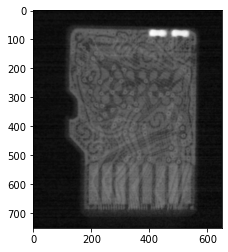

In [68]:
#afficher la  1ere image normalisee
image0 = norm[0, :, :]

plt.imshow(image0, cmap='Greys_r')
plt.show()

In [70]:
print(np.min(norm[0]),np.max(norm[0]))

-0.102639355 1.986844


In [75]:
ang = tomopy.angles(180) # Generate uniformly spaced tilt angles.

In [76]:
#recherche du centre de rotation --->La valeur trouvée n'est pas correcte, peut être amélioré avec init???
rot_center = tomopy.find_center(proj_crop, ang, init=None, ind=0, tol=0.5)
print(rot_center)

[339.21875]


In [15]:
# x = [int(rot_center), int(rot_center)]
# y = [0, proj_crop[0].shape[0]]
# plt.plot(x, y, color="white", linewidth=3)
# plt.plot(118, 338, marker='>', color="white")
# plt.plot(572,338, marker='<', color="white")
# plt.imshow(norm[1],cmap='Greys_r')

In [16]:
# plt.plot(x, y, color="white", linewidth=3)
# plt.plot(118, 338, marker='>', color="white")
# plt.plot(572,338, marker='<', color="white")
# plt.imshow(norm[178],cmap='Greys_r')

In [17]:
# anim2 = create_animation(norm, 4,4/yxratio)
# display(HTML(anim2.to_jshtml()))

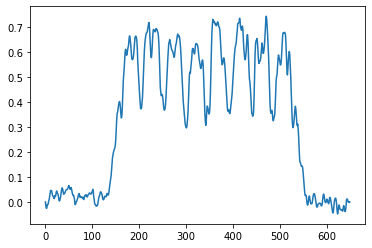

In [71]:
#test reconstruction avec differents centres de rotation
#avec sauvegarde des fichiers pour vérifier quelle est la meilleure image

dossier_reconstruct_test = 'C:/Users/cayez/Documents/DONNEES SIMON/LPCNO/Microscopie/Tomo TEM/tils series cart sd/reconstruction tomopy test centre/'

plt.plot(norm[179,600,:])
for k in range (350,450):
    rec_test_centre = tomopy.recon(norm[:,600:601,:], ang,center = [k] , algorithm='gridrec') 
    chemin_reconstruct_test = dossier_reconstruct_test+'rec_test_centre'+str(k)+'.tiff'
    matplotlib.image.imsave(chemin_reconstruct_test, rec_test_centre[0],cmap='gray')

In [77]:
print('debut')
start = datetime.datetime.now()
# reconstruction avec pour centre de rotation la valeur trouvée cellule précédente
rec = tomopy.recon(norm, ang,center =  [357] , algorithm='gridrec') # Reconstruct object.


end = datetime.datetime.now()
duree = end - start
duree
print('fin')
print(duree)

debut
fin
0:00:02.399576


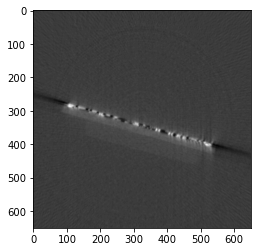

In [78]:
plt.imshow(rec[290],cmap='gray')
plt.show()

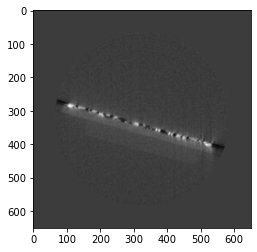

In [79]:
#masque pour enlever le cercle et modif contraste
#A AMELIORER: LE TOUR DU MASQUE CHANGE DE COULEUR SUIVANT L'IMAGE --> VISUALISATION COMPLIQUEE
mask = tomopy.circ_mask(rec, axis=0, ratio=0.8, val=0.0)



# mask = tomopy.misc.corr.circ_mask(rec_temp,0, ratio=5, val=0.3, ncore=4)
plt.imshow(mask[290],cmap='gray')
plt.show()

In [22]:
#A AMELIORER
# enhance = tomopy.misc.corr.enhance_projs_aps_1id(mask, median_ks=5, ncore=4)
# plt.imshow(enhance[290],cmap='gray')
# plt.show()


In [23]:
# #crop de reconstruction
# rec290_crop = rec[290,200:450, 40:600]
# print(np.max(rec[290,200:450, 40:600]),np.min(rec[290,200:450, 40:600]))
# plt.imshow(rec290_crop,cmap='gray')
# plt.show()

In [24]:
largeur_rec = mask[0].shape[0]
hauteur_rec = mask[0].shape[1]
yxratio_rec = hauteur_rec/largeur_rec



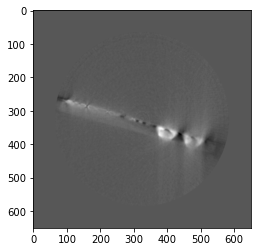

In [80]:
#Afficher une image au choix
numero_image = 70
plt.imshow(mask[numero_image],cmap='gray')
plt.show()



In [43]:
print(np.min(mask[70,200:400,150:400]),np.max(mask[70,200:400,150:400]))

-0.017881908 0.030411737


In [36]:
# mask2 = 8500*(0.017881908 +mask)
# print(np.min(mask2[70,200:400,150:400]),np.max(mask2[70,200:400,150:400]))

0.0 410.49597


In [ ]:
print(np.min(mask2[70,200:400,150:400]),np.max(mask2[70,200:400,150:400]))

In [27]:
anim3 = create_animation(mask, 4,4/yxratio_rec)
display(HTML(anim3.to_jshtml()))

Animation size has reached 20976073 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [81]:
#sauver les images reconstruites
nbre_im_reconstruct = mask.shape[0]

dossier_reconstruct = 'C:/Users/cayez/Documents/DONNEES SIMON/LPCNO/Microscopie/Tomo TEM/tils series cart sd/reconstruction tomopy/'


for i in range (nbre_im_reconstruct):
    chemin_reconstruct = dossier_reconstruct+'rec'+str(i)+'.tiff'
    matplotlib.image.imsave(chemin_reconstruct, mask2[i],vmin=0.0,vmax=300, cmap='gray')
#     matplotlib.image.imsave(chemin_reconstruct, mask[i],cmap='gray')

#     plt.savefig(chemin_reconstruct)
print(nbre_im_reconstruct, ' images reconstruites')   

750  images reconstruites
